In [1]:
%matplotlib inline
import librosa
import matplotlib.pyplot as plt
import librosa.display
import IPython.display as ipd

In [2]:
y, sr = librosa.load("../Songs/river_flows_in_you.wav")

In [3]:
def get_secs(song, secs, samrate=22050):
    return(song[:(secs*samrate)])

In [4]:
small = get_secs(y, 10)

In [16]:
y_harmonic = librosa.effects.harmonic(y, margin=3.0)

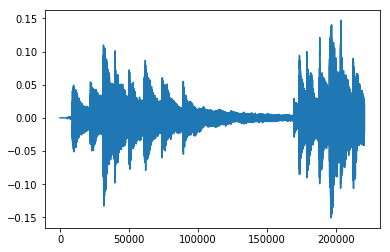

In [8]:
plt.plot(small)

In [18]:
y_harmonic

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

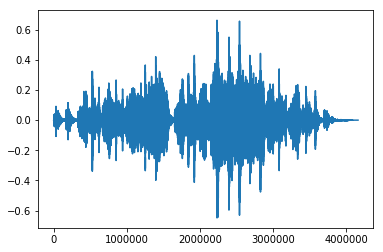

In [19]:
plt.plot(y_harmonic)

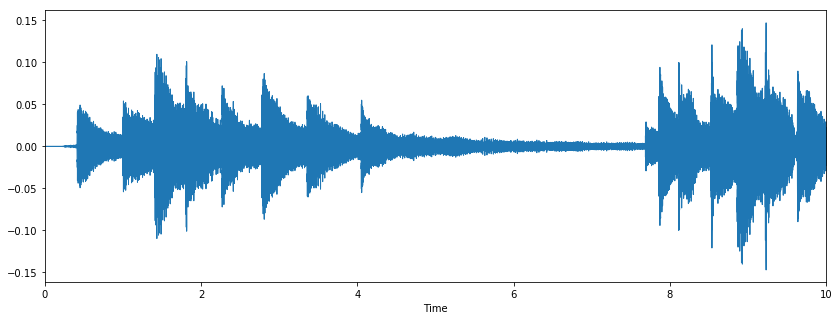

In [16]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(small, sr=sr)

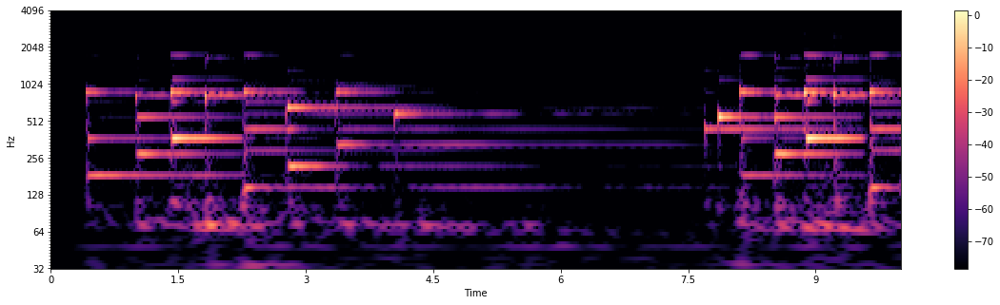

In [19]:
plt.figure(figsize=(20, 5))
C = librosa.cqt(small, sr)
librosa.display.specshow(librosa.core.amplitude_to_db(C**2),
                         x_axis='time', y_axis= 'cqt_hz')
plt.colorbar()

In [15]:
ipd.Audio(small, rate=sr)

In [30]:
ipd.Audio(y_harmonic, rate=sr)

In [22]:
ipd.Audio(y, rate=sr)

In [7]:
onset_envelope = librosa.onset.onset_strength(small, sr)
onset_frames = librosa.onset.onset_detect(y=small, units='samples', sr=sr)

In [8]:
onset_frames

array([  6144,   9216,  22528,  31232,  40448,  50176,  58368,  61440,
        74240,  89600, 169984, 173568, 179200, 188416, 195584, 203776,
       212992])

In [9]:
librosa.frames_to_time(onset_frames, sr=sr)

array([ 142.66340136,  213.99510204,  523.09913832,  725.20562358,
        939.20072562, 1165.08444444, 1355.30231293, 1426.63401361,
       1723.84943311, 2080.50793651, 3947.02077098, 4030.24108844,
       4161.01587302, 4375.01097506, 4541.45160998, 4731.66947846,
       4945.6645805 ])

In [45]:
librosa.onset.onset_detect??

In [47]:
librosa.util.peak_pick??

In [52]:
import numpy as np
o_env = librosa.onset.onset_strength(small, sr=sr)
times = librosa.frames_to_time(np.arange(len(o_env)), sr=sr)
onset_frames = librosa.onset.onset_detect(onset_envelope=o_env, sr=sr)

In [54]:
len(onset_frames)


17

In [8]:
melfb = librosa.filters.mel(22050, 2048, n_mels=8)

In [9]:
len(melfb)

8

In [10]:
melfb

array([[0.00000000e+00, 7.87699723e-05, 1.57539945e-04, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.09488545e-06, 1.04744272e-06, 0.00000000e+00]])

In [12]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128)

In [20]:
librosa.feature.melspectrogram(y=small, sr=sr)

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.62057554e-03, 1.12671397e-02, 7.35203791e-03],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.41172401e-02, 1.95069622e-02, 1.65974270e-02],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.42902954e-02, 3.77877476e-02, 3.86973710e-02],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        8.96918592e-08, 2.15794568e-07, 2.91961862e-07],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.97331800e-08, 6.30937150e-08, 9.36167182e-08],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        2.27281977e-08, 3.51132239e-08, 7.74315259e-08]])

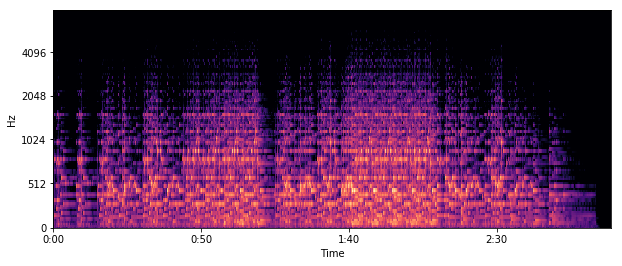

In [23]:
import numpy as np
plt.figure(figsize=(10, 4))
librosa.display.specshow(librosa.power_to_db(S,
                                              ref=np.max),
                          y_axis='mel', fmax=8000,
                          x_axis='time')

In [24]:
from scipy.signal import butter, lfilter


def butter_bandpass(lowcut, highcut, fs, order=5):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return b, a


def butter_bandpass_filter(data, lowcut, highcut, fs, order=5):
    b, a = butter_bandpass(lowcut, highcut, fs, order=order)
    y = lfilter(b, a, data)
    return y

In [67]:
fs = 5000.0
lowcut = 400.0
highcut = 1500.0

In [68]:
fil = butter_bandpass_filter(small, lowcut, highcut, sr, order=5)

In [69]:
ipd.Audio(fil, rate=sr)

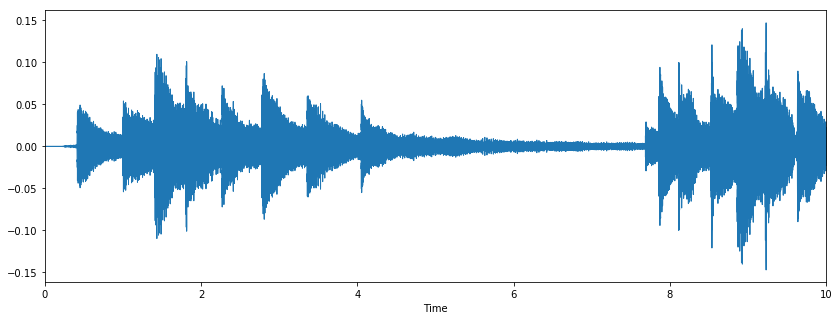

In [70]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(small, sr=sr)

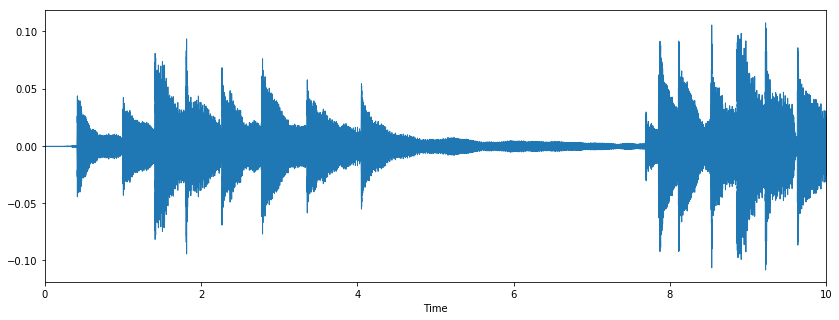

In [71]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(fil, sr=sr)